# Description

This entry contains the data and MATLAB scripts for the article EEG alpha-theta dynamics during mind wandering in the context of breath focus meditation: an experience sampling approach with novice meditation practitioners

MATLAB scripts
- read_pre_process_and_epoch_EEG.m  = import text file, pre-process EEG data, epoch relative to probe triggers, perform ICA and save matlab file
- read_pre_process_and_epoch_EOG.m  = import text file, pre-process EOG data, epoch relative to probe triggers and save matlab file
- get_behavioral_data.m  = get behavioural data (condition index, confidence and arousal) from text files
- reject_components.m = visualize ICA components per subject to reject manually (uses matlab files with clean EEG and EOG data)
- amplitude_analysis.m = perform short term fft and average across epochs 
- estimate_1f.m  = estimation of 1/f trend of average spectrum 
- findpeaks_analysisnothreshold.m/ findpeaks_analysis1fthreshold.m = estimation of transient peaks and cross-frequency ratios using find peaks approach (without and with amplitude threshold respectively)
- IF_and_PLV.m / IF_and_PLV_withfindpeaks.m= estimation of instantaneous frequency, cross-frequency ratios and phase synchrony (without and with selection of trials respectively)
- Permutation stats (folder) = code to convert data to fieldtrip-friendly structure and perform cluster permutation test (as implemented in fieldtrip) to assess differences between 2 variables of interest

Raw data
- EEG data text files = raw EEG (one column per channel) and trigger information (column 'Event'). Sampling rate is 512hz
- EOG data text files= raw EOG text files including HEOG and VEOG channels. Sampling rate is 2048Hz
*Triggers:
100 = Bell sound
101 = Breath focus answer
102 = Mind wandering answer
The two subsequent triggers indicate the self-reported level of confidence (1 to 7) and arousal (1 to 5) in each answer


Other files
- debriefings after the task (excel files)
- weights_per_epoch_after_rejection.m = condition indexes and weights based on confidence after noisy trials are rejected
- robust_estimation_1f_per_electrodeandsubject_excl_alpha.m = estimation of 1/f per subject (rows) and electrode (columns) (output from estimate_1f.m)  
- EEG21locs = matlab file with channel locations in our EEG set up

# Install Libraries

In [ ]:
!pip3 install pyEDFlib
!pip3 install wget
!pip3 install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip
!pip3 install mne
!pip3 install pyriemann
!pip3 install scipy==1.2 --upgrade
!pip3 install git+https://github.com/nbara/python-meegkit.git
!pip3 install pandas-bokeh
!pip3 install git+https://github.com/forrestbao/pyeeg

     |████████████████████████████████| 1.7 MB 5.1 MB/s 
  Created wheel for wget: filename=wget-3.2-py3-none-any.whl size=9672 sha256=7a5ed61dc4aa183bb0e6c7b97d4c61f4acbd920abd17916071d8b3493351e77d
  Stored in directory: /root/.cache/pip/wheels/a1/b6/7c/0e63e34eb06634181c63adacca38b79ff8f35c37e3c13e3c02
Successfully built wget
     - 25.9 MB 154 kB/s
     |████████████████████████████████| 10.1 MB 5.3 MB/s 
     |████████████████████████████████| 596 kB 63.3 MB/s 
     |████████████████████████████████| 102 kB 10.3 MB/s 
     |████████████████████████████████| 675 kB 52.4 MB/s 
     |████████████████████████████████| 4.7 MB 18.2 MB/s 
     |████████████████████████████████| 62 kB 862 kB/s 
     |████████████████████████████████| 812 kB 68.5 MB/s 
     |████████████████████████████████| 38.1 MB 1.2 MB/s 
  Created wheel for pandas-profiling: filename=pandas_profiling-3.1.1-py2.py3-none-any.whl size=261287 sha256=e355ba11800a285fd59ee17b8742a70f2618faff45cee37086452399543a4a0c
  Stored

In [ ]:
import re
import os
import pandas as pd
import wget
from os import listdir
from os.path import isfile, join
from pyedflib import highlevel
import numpy as np
import time
import warnings
warnings.filterwarnings('ignore')

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Functions

In [ ]:
# Decoding EOG Data
'No se esta utilizando por ahora'
def loadEOG(filename):
  data = []
  sf = 2048
  with open(filename,'r') as f:
    lines = f.readlines()
    firstregister = False
    for line in lines:
      line = line.replace('\n','')
      datasplit = line.split('\t')
      total_ocurrences = [m.start() for m in re.finditer(':', datasplit[0])]  
      if len(total_ocurrences)==2:
        try:
          val1,val2=float(datasplit[1]),float(datasplit[2])
          ncol = len(datasplit)
          firstregister = True
          data.append(datasplit)
        except:
          print('Register is not EOG:', datasplit)
  timeline = [i/sf for i in range(len(data))]
  df = pd.DataFrame(data=data, columns=['HourMinuteSeconds','EOG1','EOG2']+['Events'+str(i+1) for i in range(ncol-3)])
  df['time']=timeline
  return df.copy()

In [ ]:
from meegkit.asr import ASR
from meegkit.utils.matrix import sliding_window
from scipy.signal import butter, lfilter

# Common Average Reference Filter
def CARFiltering(df, channels):
  meanvals = df[channels].mean(axis=1).values
  for ch in channels:
    df[ch] = df[ch] - meanvals
  return df.copy()

# Filtering
def FrequencyFiltering(df, channels, sF=512.0, highcut=20.0, lowcut=1.0, order=4, typefilter='band' ):
  nyq = 0.5 * (sF)
  low = lowcut  / nyq
  high = highcut / nyq
  b, a = butter(order, [low, high], btype=typefilter)
  for ch in channels:
    df[ch] = lfilter(b, a, df[ch])
  return df.copy()

def ArtifactsRemoving(dfEEG, dfEOG, channels, sf, t1, t2, method):
  # Train ASR
  raw = dfEEG[channels].values.T
  asr = ASR(method=method)
  train_idx = np.arange(t1, t2, dtype=int)
  _, sample_mask = asr.fit(raw[:, train_idx])

  # Apply filter using sliding (non-overlapping) windows
  X = sliding_window(raw, window=int(sf), step=int(sf))
  Y = np.zeros_like(X)
  for i in range(X.shape[1]):
      Y[:, i, :] = asr.transform(X[:, i, :])
  raw_clean = Y.reshape(len(channels), -1)
  for i, ch in enumerate(channels):
    dfEEG[ch] = raw_clean[i,:]
  return dfEEG.copy()

In [ ]:
from scipy.stats import binom
# Getting chancel level according to the paper: 
# Exceeding chance level by chance: The caveat of theoretical chance levels in 
# brain signal classification and statistical assessment of decoding accuracy,
# Ettienne Combrisson and Karin Jerbi, 2015.
# URL: https://www.sciencedirect.com/science/article/pii/S0165027015000114?via%3Dihub
# DOI: https://doi.org/10.1016/j.jneumeth.2015.01.010
def chanceLevel(alpha, NSamples, NumClasses):
  return (100.0/NSamples)*(binom.ppf(1.0-alpha, NSamples, 1.0/NumClasses))
  'No se esta utilizando por ahora'

In [ ]:
#Custom Transformer for Filtering Signal
from sklearn.base import BaseEstimator, TransformerMixin
from scipy.signal import butter, lfilter
class BandPassFiltering( BaseEstimator, TransformerMixin ):
    #Class Constructor 
    def __init__( self, sF=512.0, highcut=20.0, lowcut=1.0, order=4, typefilter='band' ):
        self.sF = sF
        self.highcut = highcut
        self.lowcut = lowcut
        self.order = order
        self.typefilter = typefilter
    
    #Return self nothing else to do here    
    def fit( self, X, y = None ):
        return self
    
    #Method that describes what we need this transformer to do
    def transform( self, X, y = None ):
        nyq = 0.5 * (self.sF)
        low = self.lowcut  / nyq
        high = self.highcut / nyq
        self.b, self.a = butter(self.order, [low, high], btype=self.typefilter)
        Out = X.copy()
        for trial in range(X.shape[0]):
           for channel in  range(X.shape[1]):
              x = X[trial, channel,:]
              y = lfilter(self.b, self.a, x)
              Out[trial, channel,:] = y
        return Out

In [ ]:
#Custom Transformer for Filtering Signal
from sklearn.base import BaseEstimator, TransformerMixin
from pyriemann.estimation import Covariances
from pyriemann.tangentspace import TangentSpace
from sklearn.pipeline import make_pipeline
import numpy as np
import pyeeg
class FeaturingTF( BaseEstimator, TransformerMixin ):
    #Class Constructor 
    def __init__( self, sF=512.0, logvariance = True, tangentspace=False, hurst=False, dfa=False, pfd=False, hfd=False, permutation_entropy= False, svd_entropy=False, ap_entropy=False, fisher_info=False):
        self.sF = sF
        self.logvariance = logvariance # Logarithmic Variance
        self.tangentspace = tangentspace # Riemannian tangent space representation
        self.hurst = hurst # Hurst Exponent
        self.dfa = dfa     # Detrended Fluctuation Analysis
        self.pfd = pfd     # Petrosian Fractal Dimension
        self.hfd = hfd     # Higuchi Fractal Dimension
        self.permutation_entropy = permutation_entropy      # Permutation Entropy
        self.svd_entropy = svd_entropy                      # Singular Value Decomposition (SVD) Entropy
        self.ap_entropy = ap_entropy                        # Approximate Entropy
        self.fisher_info = fisher_info                      # Fisher Information
    
    #Return self nothing else to do here    
    def fit( self, X, y = None ):
        return self
    
    #Method that describes what we need this transformer to do
    def transform( self, X, y = None ):
        numChannels = X.shape[1]
        numObservations = X.shape[0]

        list_of_funcs = []
        if self.logvariance == True:
          list_of_funcs.append('np.log(np.var(x))')
        if self.hurst == True:
          list_of_funcs.append('pyeeg.hurst(x)')
        if self.dfa == True:
          list_of_funcs.append('pyeeg.dfa(x)')
        if self.pfd == True:
          list_of_funcs.append('pyeeg.pfd(x,range(100))')
        if self.hfd == True:
          list_of_funcs.append('pyeeg.hfd(x,10)')
        if self.permutation_entropy == True:
          list_of_funcs.append('pyeeg.permutation_entropy(x,5,1)')
        if self.svd_entropy == True:
          list_of_funcs.append('pyeeg.svd_entropy(x,5,1)')
        if self.ap_entropy == True:
          list_of_funcs.append('pyeeg.ap_entropy(x,5,1)')
        if self.fisher_info == True:
          list_of_funcs.append('pyeeg.fisher_info(x,5,1)')
        
        Out = np.zeros((numObservations,len(list_of_funcs)*numChannels))
        for trial in range(numObservations):
           for channel in  range(numChannels):
              x = X[trial, channel,:]
              for i,fun in enumerate(list_of_funcs):
                y=eval(fun)
                Out[trial, len(list_of_funcs)*channel+i] = y

        if self.tangentspace == True:
          covest = Covariances(estimator='lwf')
          ts = TangentSpace()
          featuresTS = make_pipeline(covest,ts)
          X_New = featuresTS.fit_transform(X)
          Out = np.concatenate([Out,X_New],axis=1)
        return Out

# Download Data

In [ ]:
dataPath = '/content/drive/MyDrive/AnapanaData/Rodriguez_Larios_2021/'

In [ ]:
# EEG
EEGFiles = {
    'P10_MW.csv':'https://osf.io/3s8qw/download',
    'P_11_MW.csv':'https://osf.io/q63sv/download',
    'P_12_MW.csv':'https://osf.io/he4pd/download',
    'P_13_MW.csv':'https://osf.io/ekrx3/download',
    'P_14_MW.csv':'https://osf.io/2gf3d/download',
    'P_15_MW.csv':'https://osf.io/8udar/download',
    'P_16_MW.csv':'https://osf.io/7jta8/download',
    'P_17_MW.csv':'https://osf.io/mdhv8/download',
    'P_18_MW.csv':'https://osf.io/vzr4w/download',
    'P_19_MW.csv':'https://osf.io/ph5ye/download',
    'P_1_MW.csv':'https://osf.io/3ug4r/download',
    'P_20_MW.csv':'https://osf.io/u5g3a/download',
    'P_22_MW.csv':'https://osf.io/y8u6z/download',
    'P_23_MW.csv':'https://osf.io/er6bv/download',
    'P_24_MW.csv':'https://osf.io/bmahx/download',
    'P_25_MW.csv':'https://osf.io/czbf6/download',
    'P_26_MW.csv':'https://osf.io/5f7gb/download',
    'P_27_MW.csv':'https://osf.io/sdu2n/download',
    'P_28_MW.csv':'https://osf.io/bfejt/download',
    'P_2_MW.csv':'https://osf.io/3z2nr/download',
    'P_3_MW.csv':'https://osf.io/x3s8h/download',
    'P_5_MW.csv':'https://osf.io/cbn93/download',
    'P_7_MW.csv':'https://osf.io/94syj/download',
    'P_8_MW.csv':'https://osf.io/2568z/download',
    'P_9_MW.csv':'https://osf.io/rwdf9/download'
}

listCSVFilesEEG = [f for f in listdir(dataPath) if f.endswith('.csv') and f.startswith('P') and isfile(join(dataPath, f))]
for name in list(EEGFiles.keys()):
  if name in listCSVFilesEEG:
    continue
  else:
    print(name,': Downloading...')
    wget.download(EEGFiles[name],out=os.path.join(dataPath,name))

P_11_MW.csv : Downloading...
P_12_MW.csv : Downloading...
P_13_MW.csv : Downloading...
P_14_MW.csv : Downloading...
P_15_MW.csv : Downloading...
P_16_MW.csv : Downloading...
P_17_MW.csv : Downloading...
P_18_MW.csv : Downloading...
P_19_MW.csv : Downloading...
P_1_MW.csv : Downloading...
P_20_MW.csv : Downloading...
P_22_MW.csv : Downloading...
P_23_MW.csv : Downloading...
P_24_MW.csv : Downloading...
P_25_MW.csv : Downloading...
P_26_MW.csv : Downloading...
P_27_MW.csv : Downloading...
P_28_MW.csv : Downloading...
P_2_MW.csv : Downloading...
P_3_MW.csv : Downloading...
P_5_MW.csv : Downloading...
P_7_MW.csv : Downloading...
P_8_MW.csv : Downloading...
P_9_MW.csv : Downloading...


In [ ]:
# EOG

EOGFiles = {
    'MW_P1.csv':'https://osf.io/ubzeq/download',
    'MW_P10.csv':'https://osf.io/8vb5j/download',
    'MW_P11.csv':'https://osf.io/3renq/download',
    'MW_P12.csv':'https://osf.io/k5d3n/download',
    'MW_P13.csv':'https://osf.io/a7cds/download',
    'MW_P14.csv':'https://osf.io/x638h/download',
    'MW_P15.csv':'https://osf.io/6f7np/download',
    'MW_P16.csv':'https://osf.io/7e5rx/download',
    'MW_P17.csv':'https://osf.io/hr9dk/download',
    'MW_P18.csv':'https://osf.io/wvhpu/download',
    'MW_P19.csv':'https://osf.io/9tz8r/download',
    'MW_P2.csv':'https://osf.io/aj2c3/download',
    'MW_P20.csv':'https://osf.io/smubg/download',
    'MW_P22.csv':'https://osf.io/wsg3y/download',
    'MW_P23.csv':'https://osf.io/dps4g/download',
    'MW_P24.csv':'https://osf.io/6hxyb/download',
    'MW_P25.csv':'https://osf.io/567fr/download',
    'MW_P26.csv':'https://osf.io/rkfsc/download',
    'MW_P27.csv':'https://osf.io/ytd7s/download',
    'MW_P28.csv':'https://osf.io/ubg43/download',
    'MW_P3.csv':'https://osf.io/uds5g/download',
    'MW_P5.csv':'https://osf.io/q2kt7/download',
    'MW_P7.csv':'https://osf.io/6yxa7/download',
    'MW_P8.csv':'https://osf.io/8vmtr/download',
    'MW_P9.csv':'https://osf.io/k56tc/download'
}

listCSVFilesEOG = [f for f in listdir(dataPath) if f.endswith('.csv') and f.startswith('MW') and isfile(join(dataPath, f))]
for name in list(EOGFiles.keys()):
  if name in listCSVFilesEOG:
    continue
  else:
    print(name,': Downloading...')
    wget.download(EOGFiles[name],out=name)
    df = loadEOG(name)
    df.to_csv(os.path.join(dataPath,name),index=False,sep=';',decimal='.')

MW_P12.csv : Downloading...
Register is not EOG: ['hh:mm:ss', '2048 SPS', '2048 SPS', '']
MW_P13.csv : Downloading...
Register is not EOG: ['hh:mm:ss', '2048 SPS', '2048 SPS', '']
MW_P14.csv : Downloading...
Register is not EOG: ['hh:mm:ss', '2048 SPS', '2048 SPS', '']
MW_P15.csv : Downloading...
Register is not EOG: ['hh:mm:ss', '2048 SPS', '2048 SPS', '']
MW_P16.csv : Downloading...
Register is not EOG: ['hh:mm:ss', '2048 SPS', '2048 SPS', '']
MW_P17.csv : Downloading...
Register is not EOG: ['hh:mm:ss', '2048 SPS', '2048 SPS', '']
MW_P18.csv : Downloading...
Register is not EOG: ['hh:mm:ss', '2048 SPS', '2048 SPS', '']
MW_P19.csv : Downloading...
Register is not EOG: ['hh:mm:ss', '2048 SPS', '2048 SPS', '']
MW_P20.csv : Downloading...
Register is not EOG: ['hh:mm:ss', '2048 SPS', '2048 SPS', '']
MW_P22.csv : Downloading...
Register is not EOG: ['hh:mm:ss', '2048 SPS', '2048 SPS', '']
MW_P23.csv : Downloading...
Register is not EOG: ['hh:mm:ss', '2048 SPS', '2048 SPS', '']
MW_P24.csv

# Protocol Information

In [ ]:
channels = ['FP1', 'FP2', 'F7', 'F3', 'Fz', 'F4', 'F8', 'T3', 'C3', 'Cz', 'C4',
            'T4', 'T5', 'P3', 'PZ', 'P4', 'T6', 'O1', 'O2', 'A1', 'A2']
sf = 512
sfEOG = 2048

# Import Data

In [ ]:
User = 3
dfEEG = pd.read_csv(os.path.join(dataPath,'P'+str(User)+'_MW.csv'),sep=' ')
dfEOG = pd.read_csv(os.path.join(dataPath,'MW_P'+str(User)+'.csv'),sep=';')
print('EEG: ',dfEEG.shape)
print('EOG: ',dfEOG.shape)

EEG:  (1275906, 22)
EOG:  (5103616, 6)


# Data Munging

In [ ]:
dfEOG.dtypes

HourMinuteSeconds     object
EOG1                 float64
EOG2                 float64
Events1               object
Events2              float64
time                 float64
dtype: object

In [ ]:
dfEEG = dfEEG.dropna(how='all')
dfEEG.shape

(1275904, 22)

In [ ]:
dfEEG.dtypes

FP1       float64
FP2       float64
F7        float64
F3        float64
Fz        float64
F4        float64
F8        float64
T3        float64
C3        float64
Cz        float64
C4        float64
T4        float64
T5        float64
P3        float64
PZ        float64
P4        float64
T6        float64
O1        float64
O2        float64
A1        float64
A2        float64
Events     object
dtype: object

In [ ]:
dfEEG['Events'].unique().tolist()

[nan,
 "RS232 Trigger: 1('\x01')",
 "RS232 Trigger: 101('e')",
 "RS232 Trigger: 4('\x04')",
 "RS232 Trigger: 3('\x03')",
 "RS232 Trigger: 100('d')",
 "RS232 Trigger: 102('f')",
 "RS232 Trigger: 5('\x05')",
 "RS232 Trigger: 6('\x06')",
 "RS232 Trigger: 2('\x02')",
 "RS232 Trigger: 7('\x07')",
 "RS232 Trigger: 0('"]

In [ ]:
dictReplace = dict(zip([np.nan, "RS232 Trigger: 100('d')","RS232 Trigger: 101('e')","RS232 Trigger: 102('f')",
                        "RS232 Trigger: 0('","RS232 Trigger: 1('\x01')", "RS232 Trigger: 2('\x02')",  
                        "RS232 Trigger: 3('\x03')", "RS232 Trigger: 4('\x04')",
                        "RS232 Trigger: 5('\x05')", "RS232 Trigger: 6('\x06')",
                        "RS232 Trigger: 7('\x07')", '<Paused>', 'Light Trigger', 'TTL Trigger: 1'],
                       ['No','BS','BF','MW','0','1','2','3','4','5','6','7','P', 'L','TTL1']))
dictReplace

{'<Paused>': 'P',
 'Light Trigger': 'L',
 "RS232 Trigger: 0('": '0',
 "RS232 Trigger: 1('\x01')": '1',
 "RS232 Trigger: 100('d')": 'BS',
 "RS232 Trigger: 101('e')": 'BF',
 "RS232 Trigger: 102('f')": 'MW',
 "RS232 Trigger: 2('\x02')": '2',
 "RS232 Trigger: 3('\x03')": '3',
 "RS232 Trigger: 4('\x04')": '4',
 "RS232 Trigger: 5('\x05')": '5',
 "RS232 Trigger: 6('\x06')": '6',
 "RS232 Trigger: 7('\x07')": '7',
 'TTL Trigger: 1': 'TTL1',
 nan: 'No'}

In [ ]:
dfEEG['Events'] = dfEEG['Events'].replace(dictReplace)

In [ ]:
dfEEG['Events'].unique().tolist()

['No', '1', 'BF', '4', '3', 'BS', 'MW', '5', '6', '2', '7', '0']

# Filtering Whole Raw

In [ ]:
dfEEG = FrequencyFiltering(dfEEG, channels, sF=sf, highcut=40.0, lowcut=1.0, order=4, typefilter='band' )
dfEEG = ArtifactsRemoving(dfEEG, dfEOG, channels, sf, t1=0*sf, t2=30 * sf, method = 'euclid')
dfEEG = CARFiltering(dfEEG,channels)

In [ ]:
dfEEG.describe()

,FP1,FP2,F7,F3,Fz,F4,F8,T3,C3,Cz,C4,T4,T5,P3,PZ,P4,T6,O1,O2,A1,A2
count,1.275904e+06,1.275904e+06,1.275904e+06,1.275904e+06,1.275904e+06,1.275904e+06,1.275904e+06,1.275904e+06,1.275904e+06,1.275904e+06,1.275904e+06,1.275904e+06,1.275904e+06,1.275904e+06,1.275904e+06,1.275904e+06,1.275904e+06,1.275904e+06,1.275904e+06,1.275904e+06,1.275904e+06
mean,-3.410719e-02,-3.048630e-02,-1.368387e-02,-2.693482e-03,-4.446834e-03,2.138273e-03,2.901262e-03,4.218645e-03,3.466047e-03,-5.206022e-04,4.803958e-03,9.534603e-03,5.521299e-03,6.754192e-03,4.672089e-03,4.945242e-03,-3.208226e-03,1.904075e-03,5.868189e-03,1.539020e-02,1.702843e-02
std,1.619969e+01,1.510468e+01,1.298851e+01,8.969603e+00,8.489334e+00,9.738047e+00,1.484788e+01,8.455674e+00,5.607712e+00,6.311013e+00,6.168295e+00,1.095394e+01,7.613795e+00,8.290408e+00,1.014374e+01,9.376861e+00,2.547049e+01,1.204495e+01,1.152662e+01,8.804727e+00,1.139888e+01
min,-3.731668e+02,-3.234210e+02,-4.829761e+02,-2.302715e+02,-9.196570e+01,-3.743480e+02,-1.843413e+03,-1.444116e+02,-1.229552e+02,-6.503710e+01,-4.345697e+02,-1.304301e+03,-1.324503e+02,-4.261963e+02,-2.133572e+02,-4.135987e+02,-1.563145e+03,-9.853229e+01,-2.427065e+02,-2.147263e+02,-1.156567e+03
25%,-6.689808e+00,-6.805011e+00,-6.343532e+00,-5.367498e+00,-5.203703e+00,-5.978306e+00,-6.897259e+00,-4.825911e+00,-3.300399e+00,-4.007841e+00,-3.572022e+00,-5.255475e+00,-4.479788e+00,-4.867056e+00,-5.900448e+00,-5.310411e+00,-7.755277e+00,-6.875039e+00,-6.524332e+00,-5.251019e+00,-5.863697e+00
50%,1.903989e-01,1.746339e-01,1.772780e-02,-3.027837e-02,-2.734303e-02,-8.441565e-03,2.939663e-02,7.775269e-03,-1.518241e-02,-4.790936e-03,-2.573770e-03,-3.413171e-02,-2.094552e-02,5.033760e-04,2.623653e-02,-8.398566e-03,5.705210e-02,1.043289e-01,1.174217e-01,-3.586298e-02,-3.600203e-02
75%,7.112642e+00,7.220847e+00,6.348349e+00,5.323372e+00,5.170980e+00,5.960451e+00,6.944234e+00,4.853110e+00,3.299569e+00,4.017577e+00,3.589424e+00,5.218094e+00,4.451818e+00,4.906963e+00,5.963853e+00,5.386472e+00,7.911338e+00,7.196318e+00,6.758616e+00,5.216265e+00,5.818782e+00
max,9.074841e+02,6.135382e+02,1.165854e+03,5.371572e+02,2.308441e+02,1.551669e+02,7.551968e+02,3.546907e+02,2.880687e+02,3.909650e+01,1.795110e+02,5.459364e+02,1.381766e+02,1.659086e+02,8.481156e+01,1.686252e+02,3.924365e+03,1.536592e+02,1.603517e+02,1.269778e+02,4.921853e+02


# Exploration







In [ ]:
from pandas_profiling import ProfileReport

In [ ]:
profileEEG = ProfileReport(dfEEG, title="P"+str(User)+" EEG Description", minimal=True)
profileEOG = ProfileReport(dfEOG, title="P"+str(User)+" EOG Description", minimal=True)

In [ ]:
profileEEG

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
#profileEOG

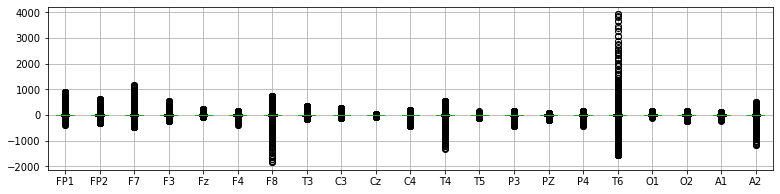

In [ ]:
%matplotlib inline
dfEEG.boxplot(column=channels, figsize=(13,3))

### How EEG signals and events evolve on time?

In [ ]:
from bokeh.plotting import figure, show
from bokeh.models import Label, Span
from bokeh.io import output_notebook
output_notebook()

chsEEG = ['C3','Cz','C4']
colorsEEG = ['red','green','blue']
chsEOG = ['EOG1','EOG2']
colorsEOG = ['black','gray']
samples = round(0.07*len(dfEEG))
init = round(0.1*len(dfEEG))

# Create a new plot with a title and axis labels
p = figure(title="EEG and Events on time", x_axis_label="time (s)", 
           y_axis_label="Amplitude uV", plot_width=800, plot_height=300, output_backend="webgl")

# Plot EEG
x = [val/sf for val in range(len(dfEEG))]
x = x[init:init+samples]


maxText = -np.inf
minText = +np.inf

## Plot EEG
for color,ch in zip(colorsEEG,chsEEG):
  #Signal
  y = dfEEG[ch].values.tolist()
  y = y[init:init+samples]
  maxText = max([maxText,max(y)])
  minText = min([minText,min(y)])
  # Add a line renderer with legend and line thickness
  p.circle(x, y, legend_label=ch, line_width=2,color=color)

## Plot EOG
for color,ch in zip(colorsEOG,chsEOG):
  #Signal
  dfSubEOG = dfEOG[(dfEOG['time']>=init/sf) & (dfEOG['time']<=(samples+init)/sf)]
  y = dfSubEOG[ch].values.tolist()
  x = dfSubEOG['time'].values.tolist()
  maxText = max([maxText,max(y)])
  minText = min([minText,min(y)])
  # Add a line renderer with legend and line thickness
  p.circle(x, y, legend_label=ch, line_width=1,color=color)

## Events
timesBS = [i/sf for i,val in enumerate(dfEEG['Events'].values.tolist()) if val is 'BS']
timesBF = [i/sf for i,val in enumerate(dfEEG['Events'].values.tolist()) if val is 'BF']
timesMW = [i/sf for i,val in enumerate(dfEEG['Events'].values.tolist()) if val is 'MW']
timesZeros = [i/sf for i,val in enumerate(dfEEG['Events'].values.tolist()) if val is '0']
timesOnes = [i/sf for i,val in enumerate(dfEEG['Events'].values.tolist()) if val is '1']
timesTwos = [i/sf for i,val in enumerate(dfEEG['Events'].values.tolist()) if val is '2']
timesThrees = [i/sf for i,val in enumerate(dfEEG['Events'].values.tolist()) if val is '3']
timesFours = [i/sf for i,val in enumerate(dfEEG['Events'].values.tolist()) if val is '4']
timesFives = [i/sf for i,val in enumerate(dfEEG['Events'].values.tolist()) if val is '5']
timesSixs = [i/sf for i,val in enumerate(dfEEG['Events'].values.tolist()) if val is '6']
timesSevens = [i/sf for i,val in enumerate(dfEEG['Events'].values.tolist()) if val is '7']

vlinesBS = []
for t in timesBS:
  if t < (samples+init)/sf and t > init/sf:
    txt = Label(x=t, y=maxText-(0.1*np.abs(maxText-minText)), text='BS', text_align='right', text_color='black')
    vline = Span(location=t, dimension='height', line_color='black', line_width=2)
    vlinesBS.append(vline)
    p.add_layout(txt)

vlinesBF = []
for t in timesBF:
  if t < (samples+init)/sf and t > init/sf:
    txt = Label(x=t, y=minText, text='BF', text_color='orange')
    vline = Span(location=t, dimension='height', line_color='orange', line_width=2)
    vlinesBF.append(vline)
    p.add_layout(txt)

vlinesMW = []
for t in timesMW:
  if t < (samples+init)/sf and t > init/sf:
    txt = Label(x=t, y=minText, text='MW', text_color='magenta')
    vline = Span(location=t, dimension='height', line_color='magenta', line_width=2)
    vlinesMW.append(vline)
    p.add_layout(txt)

vlinesZeros = []
for t in timesOnes:
  if t < (samples+init)/sf and t > init/sf:
    txt = Label(x=t, y=maxText-(0.1*np.abs(maxText-minText)), text='0', text_color='gray')
    vline = Span(location=t, dimension='height', line_color='gray', line_width=2)
    vlinesZeros.append(vline)
    p.add_layout(txt)

vlinesOnes = []
for t in timesOnes:
  if t < (samples+init)/sf and t > init/sf:
    txt = Label(x=t, y=maxText-(0.1*np.abs(maxText-minText)), text='1', text_color='gray')
    vline = Span(location=t, dimension='height', line_color='gray', line_width=2)
    vlinesOnes.append(vline)
    p.add_layout(txt)

vlinesTwos = []
for t in timesTwos:
  if t < (samples+init)/sf and t > init/sf:
    txt = Label(x=t, y=maxText-(0.1*np.abs(maxText-minText)), text='2', text_color='gray')
    vline = Span(location=t, dimension='height', line_color='gray', line_width=2)
    vlinesTwos.append(vline)
    p.add_layout(txt)

vlinesThrees = []
for t in timesThrees:
  if t < (samples+init)/sf and t > init/sf:
    txt = Label(x=t, y=maxText-(0.1*np.abs(maxText-minText)), text='3', text_color='gray')
    vline = Span(location=t, dimension='height', line_color='gray', line_width=2)
    vlinesThrees.append(vline)
    p.add_layout(txt)

vlinesFours = []
for t in timesFours:
  if t < (samples+init)/sf and t > init/sf:
    txt = Label(x=t, y=maxText-(0.1*np.abs(maxText-minText)), text='4', text_color='gray')
    vline = Span(location=t, dimension='height', line_color='gray', line_width=2)
    vlinesFours.append(vline)
    p.add_layout(txt)

vlinesFives = []
for t in timesFives:
  if t < (samples+init)/sf and t > init/sf:
    txt = Label(x=t, y=maxText-(0.1*np.abs(maxText-minText)), text='5', text_color='gray')
    vline = Span(location=t, dimension='height', line_color='gray', line_width=2)
    vlinesFives.append(vline)
    p.add_layout(txt)

vlinesSixs = []
for t in timesSixs:
  if t < (samples+init)/sf and t > init/sf:
    txt = Label(x=t, y=maxText-(0.1*np.abs(maxText-minText)), text='6', text_color='gray')
    vline = Span(location=t, dimension='height', line_color='gray', line_width=2)
    vlinesSixs.append(vline)
    p.add_layout(txt)

vlinesSevens = []
for t in timesSevens:
  if t < (samples+init)/sf and t > init/sf:
    txt = Label(x=t, y=maxText-(0.1*np.abs(maxText-minText)), text='7', text_color='gray')
    vline = Span(location=t, dimension='height', line_color='gray', line_width=2)
    vlinesSevens.append(vline)
    p.add_layout(txt)

p.renderers.extend(vlinesBS+vlinesBF+vlinesMW+vlinesZeros+vlinesOnes+vlinesTwos+vlinesThrees+vlinesFours+vlinesFives+vlinesSixs+vlinesSevens)

# Show the results
show(p)

# Epoching + Labeling

In [ ]:
# Linear Search + State Machine Algorithm
qualifications = ['1','2','3','4','5','6','7','8']
searchForLabel = False
searchForQ1 = False
searchForQ2 = False
listIndexEndBS = []
listLabels = []
listQ1 = []
listQ2 = []
for i,val in enumerate(dfEEG['Events'].values.tolist()):
  if searchForQ2 == True:
    if val in qualifications:
      listQ2[-1] = val
      searchForQ2 = False

  if searchForQ1 == True:
    if val in qualifications:
      listQ1[-1] = val
      searchForQ2 = True
      searchForQ1 = False

  if searchForLabel == True:
    if val in ['BF','MW']:
      listLabels[-1] = val
      searchForLabel = False
      searchForQ1 = True

  if val is 'BS':
    indexEndBS = i
    listIndexEndBS.append(indexEndBS)
    searchForLabel = True
    searchForQ2 = False
    searchForQ1 = False
    listLabels.append('NoLabel')
    listQ1.append('No')
    listQ2.append('No')

print(len(listIndexEndBS),' detections: ',(listIndexEndBS))
print(len(listLabels),' detections: ',(listLabels))
print(len(listQ1),' detections: ',(listQ1))
print(len(listQ2),' detections: ',(listQ2))

40  detections:  [211377, 239615, 273022, 299853, 326745, 345609, 379463, 410039, 432678, 459258, 479978, 500055, 521036, 556603, 575859, 594817, 621342, 645141, 682529, 702400, 730677, 750990, 784780, 819468, 852717, 891666, 911051, 927951, 961380, 984448, 1016696, 1037062, 1065952, 1087370, 1113116, 1138179, 1170931, 1190032, 1226145, 1263714]
40  detections:  ['MW', 'BF', 'BF', 'BF', 'BF', 'MW', 'BF', 'BF', 'MW', 'BF', 'MW', 'BF', 'MW', 'BF', 'MW', 'BF', 'BF', 'MW', 'BF', 'BF', 'BF', 'BF', 'MW', 'BF', 'BF', 'BF', 'MW', 'MW', 'BF', 'BF', 'BF', 'BF', 'BF', 'BF', 'BF', 'BF', 'BF', 'BF', 'BF', 'MW']
40  detections:  ['5', '5', '4', '6', '3', '5', '3', '6', '3', '5', '2', '6', '3', '6', '6', '1', '3', '7', '5', '6', '6', '3', '3', '2', '3', '7', '6', '5', '3', '6', '5', '5', '3', '1', '7', '6', '5', '5', '1', '3']
40  detections:  ['4', '4', '5', '5', '5', '4', '5', '4', '4', '4', '4', '5', '4', '4', '5', '4', '4', '4', '4', '5', '5', '3', '4', '4', '4', '4', '3', '3', '3', '4', '4', '4'

In [ ]:
dfLabels = pd.DataFrame({
    'IndexBS': listIndexEndBS,
    'Labels': listLabels,
    'ConfidenceOnBFMW': listQ1,
    'CalmOrExcitedBS': listQ2
})
dfLabels

,IndexBS,Labels,ConfidenceOnBFMW,CalmOrExcitedBS
0,211377,MW,5,4
1,239615,BF,5,4
2,273022,BF,4,5
3,299853,BF,6,5
4,326745,BF,3,5
5,345609,MW,5,4
6,379463,BF,3,5
7,410039,BF,6,4
8,432678,MW,3,4
9,459258,BF,5,4


In [ ]:
dfLabels['Labels'].value_counts()

BF    29
MW    11
Name: Labels, dtype: int64

In [ ]:
# Validation
dfFilt = dfEEG[~dfEEG['Events'].isin(['No'])]
dfFilt = dfFilt.reset_index()
dfFilt = dfFilt[[col for col in dfFilt.columns.tolist() if col not in channels]]
annotations = []
for val1, val2 in zip(dfFilt['index'],dfFilt['Events']):
  if val2 is 'BS':
    print('')
  print(val1,':',val2)
  annotations.append([val1/sf,0.1,val2])

74013 : 1
78377 : BF
81274 : 4
83789 : 3

211377 : BS
214705 : MW
215901 : 5
218023 : 4

239615 : BS
243092 : BF
246869 : 5
250564 : 4

273022 : BS
275968 : BF
277205 : 4
279238 : 5

299853 : BS
302070 : BF
303659 : 6
304446 : 5

326745 : BS
330138 : BF
331440 : 3
332644 : 5

345609 : BS
347858 : MW
351700 : 5
353617 : 4

379463 : BS
382913 : BF
385412 : 3
386452 : 5

410039 : BS
411874 : BF
413537 : 6
415241 : 4

432678 : BS
436279 : MW
437606 : 3
442604 : 4

459258 : BS
461921 : BF
462987 : 5
464117 : 4

479978 : BS
482771 : MW
485426 : 2
486745 : 4

500055 : BS
502589 : BF
503449 : 6
503941 : 5

521036 : BS
523546 : MW
525340 : 3
529296 : 4

556603 : BS
558912 : BF
559486 : 6
560829 : 4

575859 : BS
578771 : MW
579336 : 6
583154 : 5

594817 : BS
597229 : BF
598547 : 1
600965 : 4

621342 : BS
627803 : BF
630826 : 3
632391 : 4

645141 : BS
648186 : MW
653150 : 7
664038 : 4

682529 : BS
685027 : BF
686051 : 5
690287 : 4

702400 : BS
704239 : BF
704746 : 6
705673 : 5

730677 : BS
732470

In [ ]:
# Save EDF file
signals = dfEEG[channels].values.T
minEEG = dfEEG[channels].min().min()
maxEEG = dfEEG[channels].max().max()
mEEG = max([abs(minEEG),abs(maxEEG)])
channel_names = channels
signal_headers = highlevel.make_signal_headers(channel_names, sample_rate=sf, physical_max= mEEG, physical_min=-1*mEEG)
header = highlevel.make_header(patientname='P'+str(User),  gender='')
header['annotations']=annotations
highlevel.write_edf('P'+str(User)+'_EEG.edf', signals, signal_headers, header)

True

In [ ]:
dfEOG.columns

Index(['HourMinuteSeconds', 'EOG1', 'EOG2', 'Events1', 'Events2', 'time'], dtype='object')

In [ ]:
# Save EDF file
channelsEOG = ['EOG1', 'EOG2']
signals = dfEOG[channelsEOG].values.T
minEEG = dfEOG[channelsEOG].min().min()
maxEEG = dfEOG[channelsEOG].max().max()
mEEG = max([abs(minEEG),abs(maxEEG)])
channel_names = channelsEOG
signal_headers = highlevel.make_signal_headers(channel_names, sample_rate=sfEOG, physical_max= mEEG, physical_min=-1*mEEG)
header = highlevel.make_header(patientname='P'+str(User),  gender='')
header['annotations']=annotations
highlevel.write_edf('P'+str(User)+'_EOG.edf', signals, signal_headers, header)

True

In [ ]:
## Apply some filtering
# dfLabels = dfLabels[dfLabels['ConfidenceOnBFMW'].isin(['6'])]

# listIndexEndBS = dfLabels['IndexBS'].values.tolist()
# listLabels = dfLabels['Labels'].values.tolist()

In [ ]:
# Epoching
lengthEpoch = 5
listEpochs = []
for i in listIndexEndBS:
  dfEpoch = dfEEG[i - (sf*lengthEpoch) - 1:i - 1].copy() # Index filtering
  dfEpoch = dfEpoch.reset_index()                        # Reset index
  dfEpoch = dfEpoch[channels]                            # Retrieve EEG channels
  listEpochs.append(dfEpoch.copy())                      # Full Copy, not reference.

In [ ]:
listLabels[0], listEpochs[0]

('MW',
             FP1        FP2        F7  ...         O2         A1        A2
 0     -8.013002 -12.198214  0.056878  ... -21.219264   4.998971 -0.201395
 1     -7.023410 -10.477573  0.210592  ... -22.652475   4.006382 -0.106999
 2     -5.979615  -8.737200  0.375451  ... -23.308315   3.102229  0.251849
 3     -4.666918  -7.050848  0.852606  ... -23.459057   2.366509  0.705240
 4     -2.992766  -5.522469  1.790614  ... -23.377275   1.768786  1.056424
 ...         ...        ...       ...  ...        ...        ...       ...
 2555 -10.159167 -11.304961 -4.634931  ...  18.544710   7.243112  8.415250
 2556  -9.963197 -11.497832 -4.394894  ...  17.590783   8.686917  5.120454
 2557  -9.717569 -11.267304 -4.367133  ...  16.453384  10.519397  1.462602
 2558  -9.315566 -10.676693 -4.495087  ...  15.095442  12.375626 -2.295332
 2559  -8.696987  -9.867262 -4.666782  ...  13.461939  13.878389 -5.916687
 
 [2560 rows x 21 columns])

# Classification

In [ ]:
# Preparing data for Classification
X = [val.values.T for val in listEpochs] #Array Dim: Ntrials X Nchannels X Nsamples
X = np.stack(X, axis=0)

dictClass = {'BF':0,'MW':1}
y = np.array([dictClass[val] for val in listLabels])
X.shape, y.shape

((40, 21, 2560), (40,))

In [ ]:
# Creating Machine Learning Models

# Scikit-Learn
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.linear_model import LogisticRegression
from sklearn.neural_network import MLPClassifier
from sklearn.svm import SVC
from sklearn.pipeline import make_pipeline
from sklearn.model_selection import StratifiedKFold, cross_val_score
from sklearn.metrics import accuracy_score

# MNE
from mne.decoding import CSP

#PyRiemann
from pyriemann.spatialfilters import Xdawn

# Pipeline 1
#Frequency Filter
bpf1 = BandPassFiltering(sF=sf, highcut=14.0, lowcut=4.0, order=4, typefilter='band')
#Spatial Filter
csp1 = CSP(n_components=len(channels), reg=0.01, transform_into='csp_space',  norm_trace=False)
xdawn1 = Xdawn(nfilter=round(len(channels)/2), estimator='lwf')
#Feature extraction
f_tf1 = FeaturingTF(sF=sf, logvariance = True, tangentspace=True, hurst=False, dfa=False, pfd=False, hfd=False, permutation_entropy= False, svd_entropy=False, ap_entropy=False, fisher_info=False)
#Classifier
lda1 = LinearDiscriminantAnalysis(solver='svd')
#Pipeline
clf1 = make_pipeline(bpf1,xdawn1, f_tf1, lda1)

# Pipeline 2
#Frequency Filter
bpf2 = BandPassFiltering(sF = sf, highcut = 14.0, lowcut=4.0, order=4, typefilter='band')
#Spatial Filter
csp2 = CSP(n_components=len(channels), reg=0.01, transform_into='csp_space', norm_trace=False)
xdawn2 = Xdawn(nfilter=round(len(channels)/2), estimator='lwf')
#Feature extraction
f_tf2 = FeaturingTF(sF = sf, logvariance = True, tangentspace=True,  hurst=False, dfa=False, pfd=False, hfd=False, permutation_entropy= False, svd_entropy=False, ap_entropy=False, fisher_info=False)
#Classifier
svc2 = SVC(kernel='linear', C=1)
#Pipeline
clf2 = make_pipeline(bpf2, xdawn2, f_tf2, svc2)

# Pipeline 3
#Frequency Filter
bpf3 = BandPassFiltering(sF=sf, highcut=14.0, lowcut=4.0, order=4, typefilter='band')
#Spatial Filter
csp3 = CSP(n_components=len(channels), reg=0.01, transform_into='csp_space', norm_trace=False)
xdawn3 = Xdawn(nfilter=round(len(channels)/2), estimator='lwf')
#Feature extraction
f_tf3 = FeaturingTF(sF=sf, logvariance = True, tangentspace=True, hurst=False, dfa=False, pfd=False, hfd=False, permutation_entropy= False, svd_entropy=False, ap_entropy=False, fisher_info=False)
#Classifier
lg3 = LogisticRegression(penalty='l2', solver='lbfgs', max_iter=100, random_state=0)
#Pipeline
clf3 = make_pipeline(bpf3,xdawn3,f_tf3, lg3)

# Pipeline 4
#Frequency Filter
bpf4 = BandPassFiltering(sF=sf, highcut=14.0, lowcut=4.0, order=4, typefilter='band')
#Spatial Filter
csp4 = CSP(n_components=len(channels), reg=0.01, transform_into='csp_space', norm_trace=False)
xdawn4 = Xdawn(nfilter=round(len(channels)/2), estimator='lwf')
#Feature extraction
f_tf4 = FeaturingTF(sF=sf, logvariance = True, tangentspace=True, hurst=False, dfa=False, pfd=False, hfd=False, permutation_entropy=False, svd_entropy=False, ap_entropy=False, fisher_info=False)
#Classifier
mlp4 = MLPClassifier(solver='lbfgs', alpha=1e-5, hidden_layer_sizes=(5, 2), random_state=1)
#Pipeline
clf4 = make_pipeline(bpf4,xdawn4,f_tf4, mlp4)


# Concat Pipelines and their names
pipelines = [clf1, clf2, clf3, clf4]
pipelines_names = ['LDA', 'SVM', 'LR','MLP']

# Performance Evaluation

In [ ]:
# For each pipeline get accuracy on cross validation
listAccuracyFold = []
listTimes = []
for clf,clfname in zip(pipelines,pipelines_names):
  start = time.time()
  print('Evaluating pipeline = '+clfname)
  # Cross validation
  # Stratified Cross-validation
  cv = StratifiedKFold(n_splits=10, random_state=None, shuffle=False)
  scores = cross_val_score(clf, X, y, cv=cv)
  'set balanced_accuracy for imbalacend datasets MW/BF'
  listAccuracyFold.append(scores)
  fold = [j+1 for j in range(len(scores))]
  end = time.time()
  listTimes.append((end-start)/60)

Evaluating pipeline = LDA
Evaluating pipeline = SVM
Evaluating pipeline = LR
Evaluating pipeline = MLP


In [ ]:
listAccuracyFold, listTimes

([array([0.5 , 0.75, 0.75, 0.75, 0.75, 0.5 , 0.75, 0.75, 0.75, 0.75]),
  array([0.75, 1.  , 0.5 , 0.75, 1.  , 0.75, 0.75, 0.75, 0.75, 0.75]),
  array([0.5 , 1.  , 0.75, 0.75, 0.75, 0.75, 0.75, 0.75, 0.75, 0.75]),
  array([0.5 , 0.75, 0.75, 0.75, 0.75, 0.75, 0.75, 0.5 , 0.75, 0.75])],
 [0.10524949232737223,
  0.10282513300577799,
  0.1042355219523112,
  0.1042870044708252])

In [ ]:
y

array([1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0,
       1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1])

In [ ]:
for clfname, score in zip(pipelines_names,listAccuracyFold):
  print(score)
  print(clfname,':',score.mean(),'+-',score.std())
  print('')

[0.5  0.75 0.75 0.75 0.75 0.5  0.75 0.75 0.75 0.75]
LDA : 0.7 +- 0.09999999999999999

[0.75 1.   0.5  0.75 1.   0.75 0.75 0.75 0.75 0.75]
SVM : 0.775 +- 0.13462912017836262

[0.5  1.   0.75 0.75 0.75 0.75 0.75 0.75 0.75 0.75]
LR : 0.75 +- 0.11180339887498948

[0.5  0.75 0.75 0.75 0.75 0.75 0.75 0.5  0.75 0.75]
MLP : 0.7 +- 0.09999999999999999



In [ ]:
import plotly.graph_objects as go

fig = go.Figure()
for clfname, score in zip(pipelines_names,listAccuracyFold):
  fig.add_trace(go.Box(y=score,name=clfname))
  #fig.update_traces(boxpoints='all', jitter=0)
fig.show()